<a href="https://colab.research.google.com/github/ghotek/cvr_course/blob/develop/notebooks/cv_hw3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Homework 3**

## №1, №2, №3

In [ ]:
!git clone https://github.com/ghotek/cvr_course.git

Cloning into 'cvr_course'...
remote: Enumerating objects: 534, done.
remote: Total 534 (delta 0), reused 0 (delta 0), pack-reused 534
Receiving objects: 100% (534/534), 65.32 MiB | 36.51 MiB/s, done.
Resolving deltas: 100% (127/127), done.


In [ ]:
cd cvr_course/notebooks

/content/cvr_course/notebooks


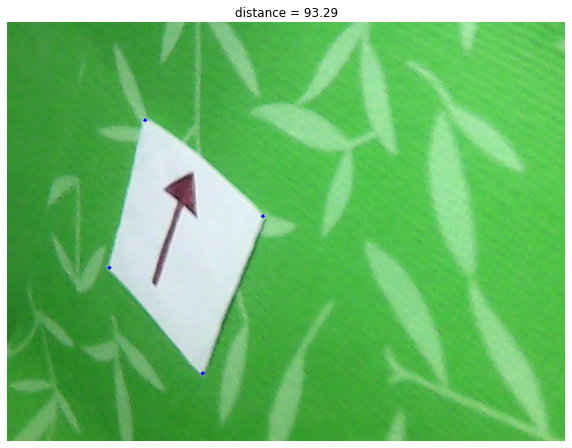

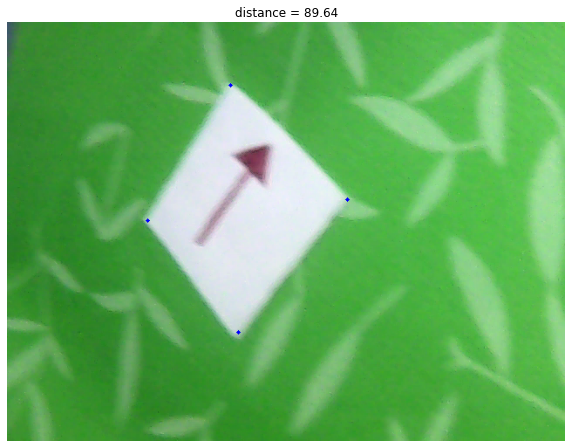

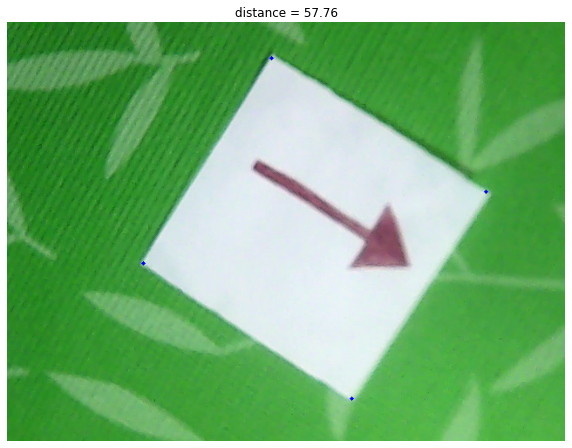

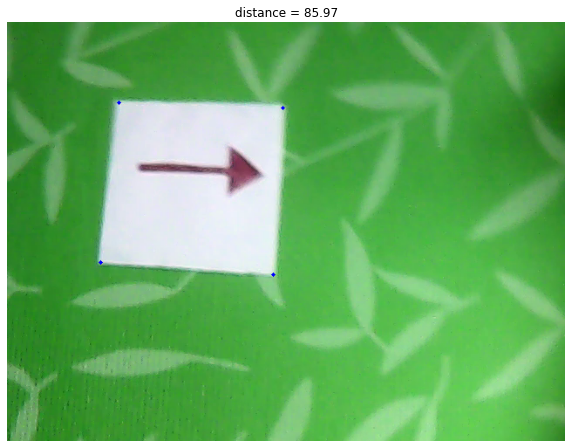

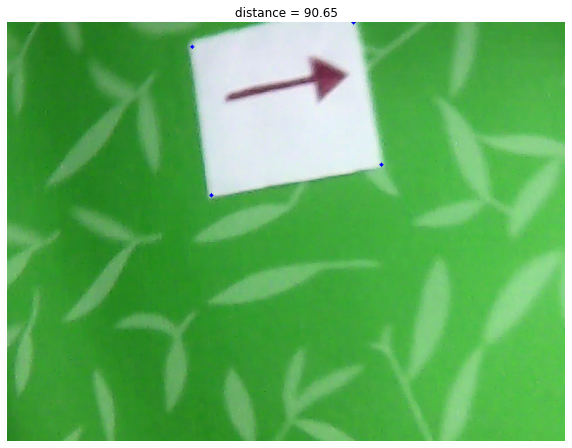

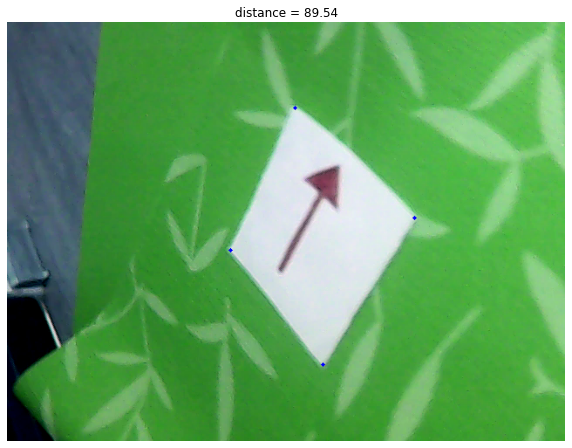

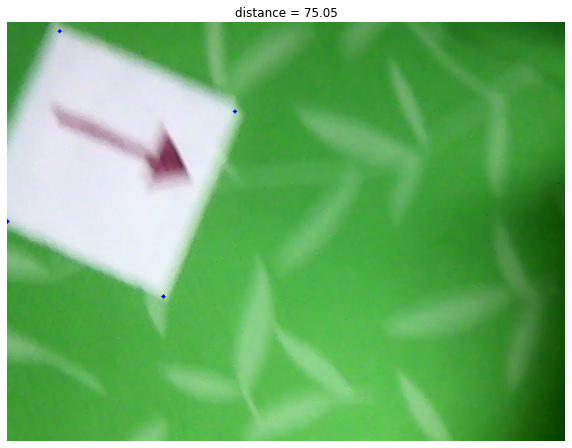

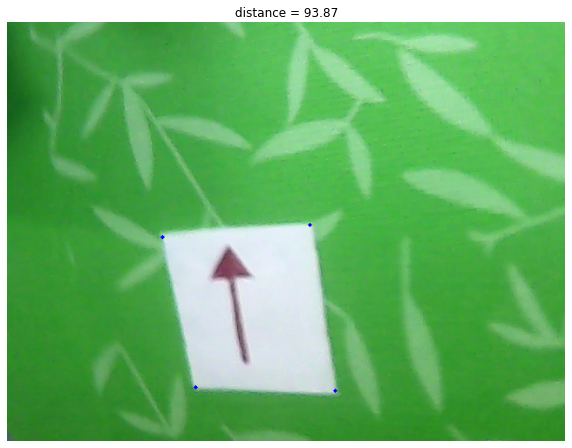

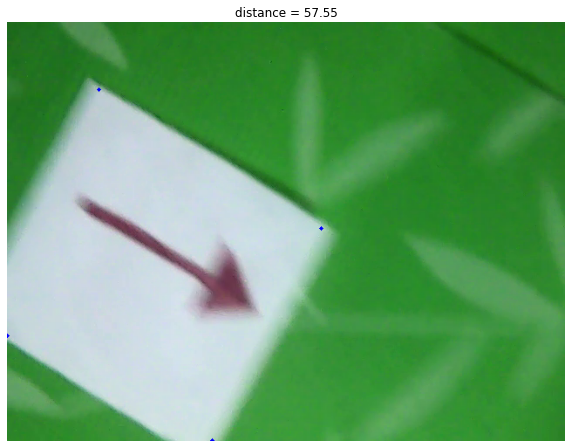

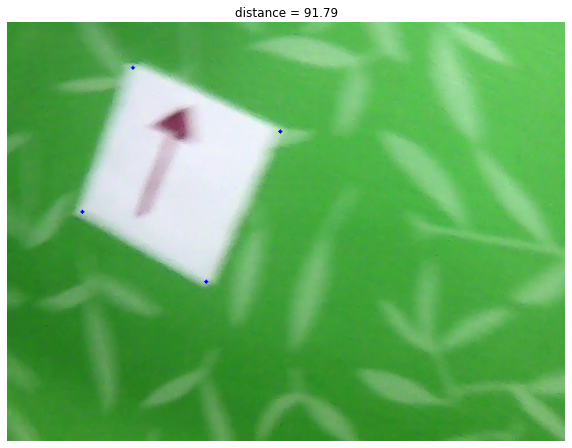

In [ ]:
import numpy as np
import cv2
import time
import os
import math
import sys
import glob
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = (10,10)
 
def find_contour (img, low_th, high_th):
    img_rgb = cv2.cvtColor (img, cv2.COLOR_BGR2RGB)
    
    mask = cv2.inRange (img, low_th, high_th)
    
    contours, hierarchy = cv2.findContours (mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnt = contours [len(contours) - 1]
    approx = cv2.convexHull (cnt)
 
    epsilon = 0.05 * cv2.arcLength (approx, True)
    approx = cv2.approxPolyDP (approx, epsilon, True)
 
    return approx
 
def find_distance (img):
    low_th  = (180, 180, 180)
    high_th = (255, 255, 255)
 
    contour = find_contour (img, low_th, high_th)
    
    length = cv2.arcLength (contour, True)
 
    if length != 0:
        distance = 180.0 * 364 / length
    else:
        distance = 0
    
    return distance
 
 
images = glob.glob('../data/imgs/arrow/*.png')
low_th  = (180, 180, 180)
high_th = (255, 255, 255)
 
for fname in images:
    img = cv2.imread(fname)
    cnt = find_contour(img, low_th, high_th)
    dist = find_distance(img)
    plt.title("distance = " + "%.2f" % dist)
    cv2.drawContours(img, cnt, -1, (0, 0, 255), 3)
    plt.imshow (img)
    plt.axis ('off')
    plt.show ()

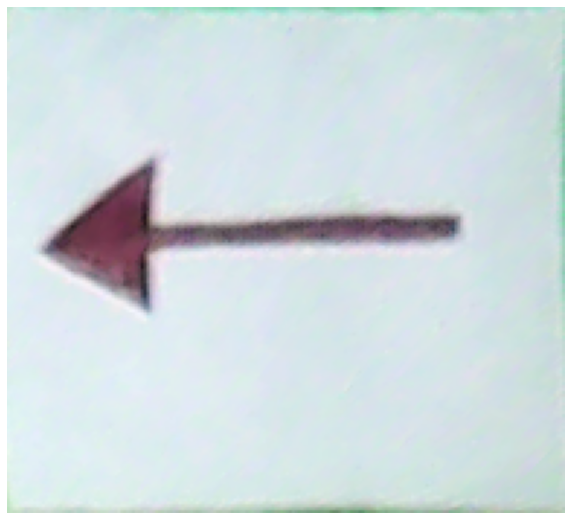

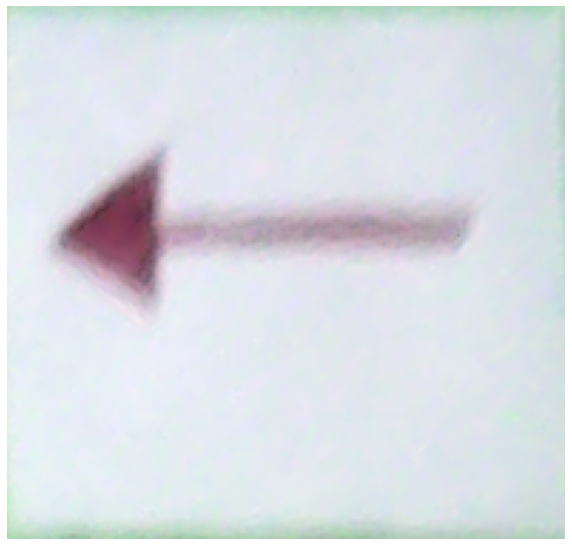

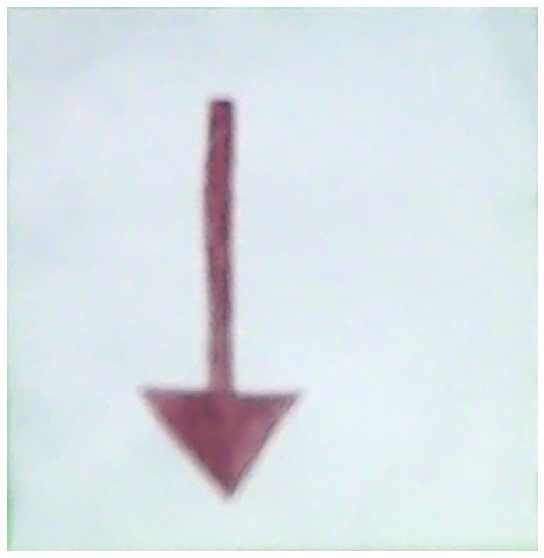

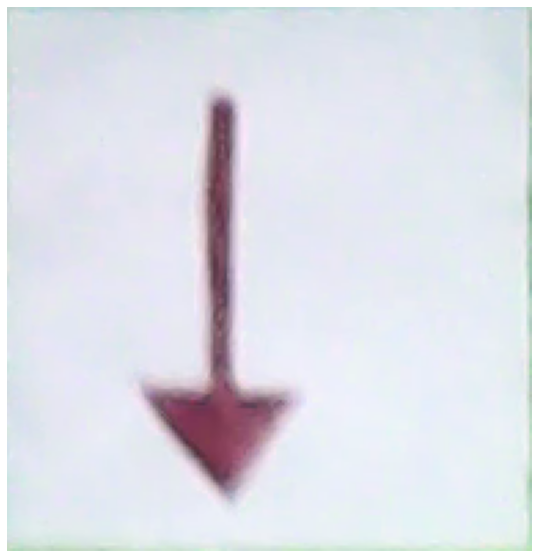

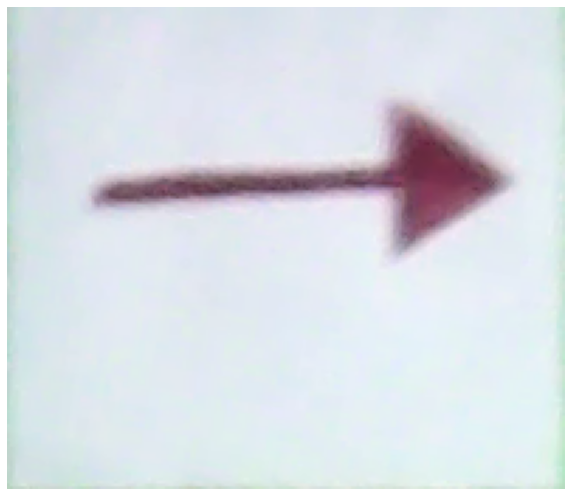

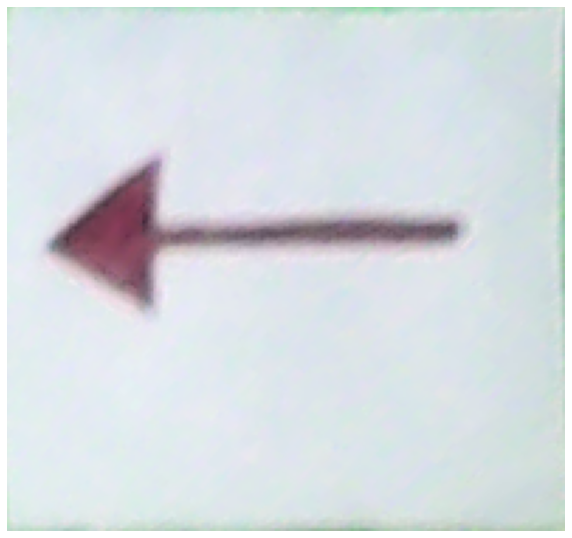

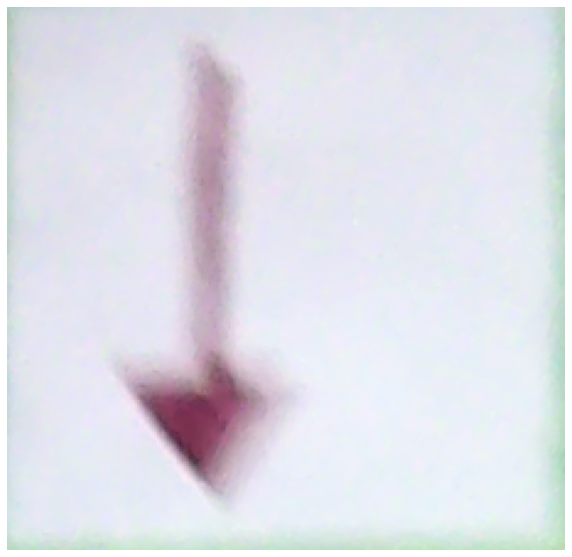

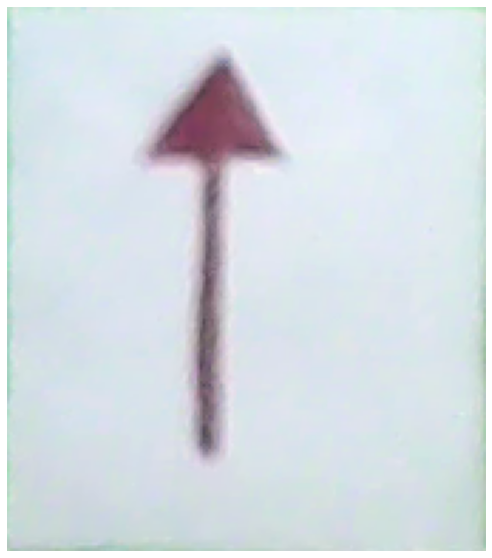

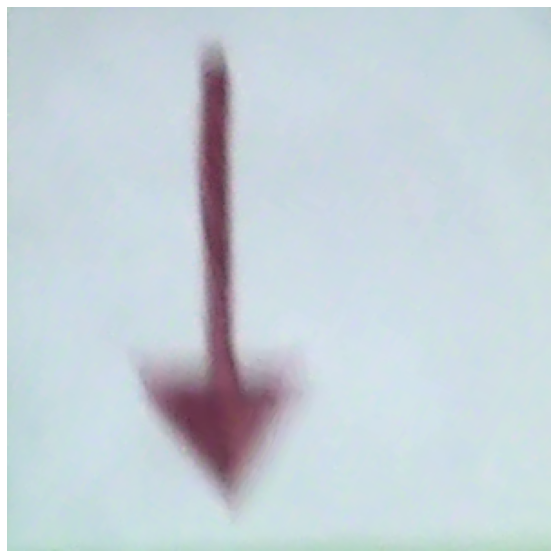

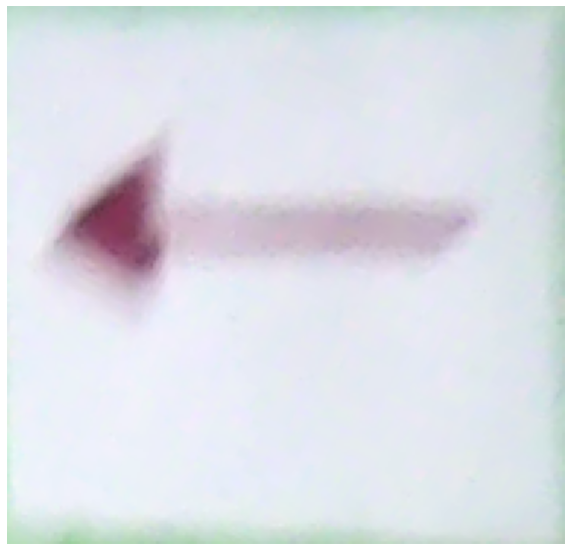

In [ ]:
def order_points(pts):
    rect = np.zeros((4, 2), dtype="float32")
    
    s = pts.sum(axis=1)
    rect[0] = pts[np.argmin(s)]
    rect[2] = pts[np.argmax(s)]
    pts[np.argmax(s)] = [0, 0]
    pts[np.argmin(s)] = [0, 0]    

    s = pts.sum(axis=1)
    rect[3] = pts[np.argmax(s)]
    s[np.argmax(s)] = 0
    for i in range(len(s)):
        if s[i] != 0:
            rect[1] = pts[i]

    return rect

def four_point_transform(image, pts):
    rect = order_points(pts)
    (tl, tr, br, bl) = rect
    
    widthA = np.sqrt(((br[0] - bl[0]) ** 2) + ((br[1] - bl[1]) ** 2))
    widthB = np.sqrt(((tr[0] - tl[0]) ** 2) + ((tr[1] - tl[1]) ** 2))
    maxWidth = max(int(widthA), int(widthB))
    
    heightA = np.sqrt(((tr[0] - br[0]) ** 2) + ((tr[1] - br[1]) ** 2))
    heightB = np.sqrt(((tl[0] - bl[0]) ** 2) + ((tl[1] - bl[1]) ** 2))
    maxHeight = max(int(heightA), int(heightB))
    
    dst = np.array([
        [0, 0],
        [maxWidth - 1, 0],
        [maxWidth - 1, maxHeight - 1],
        [0, maxHeight - 1]], dtype="float32")
    
    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(image, M, (maxWidth, maxHeight))
    
    return warped

warped_imgs = []
for fname in images:
    img = cv2.imread(fname)
    approx_cnt = find_contour(img, low_th, high_th)
    warped = four_point_transform (img, np.asarray (approx_cnt) [:, 0, :])
    warped_imgs.append(warped)
    
    plt.imshow (warped)
    plt.axis ('off')
    plt.show ()
    

## №4

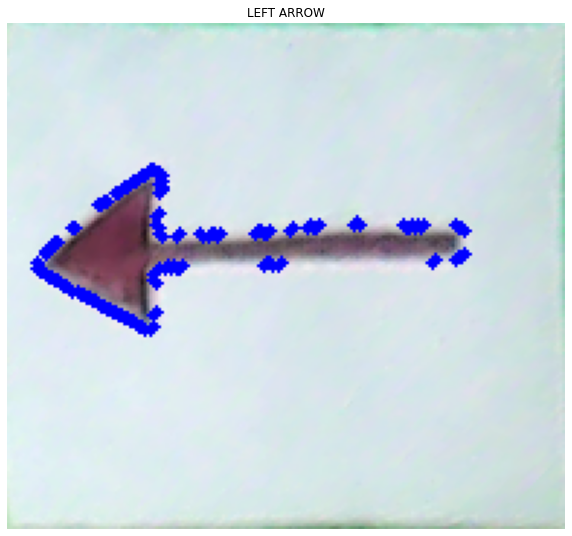

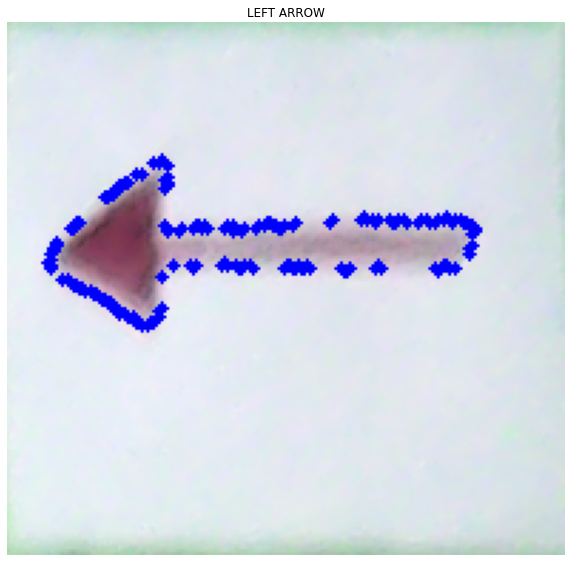

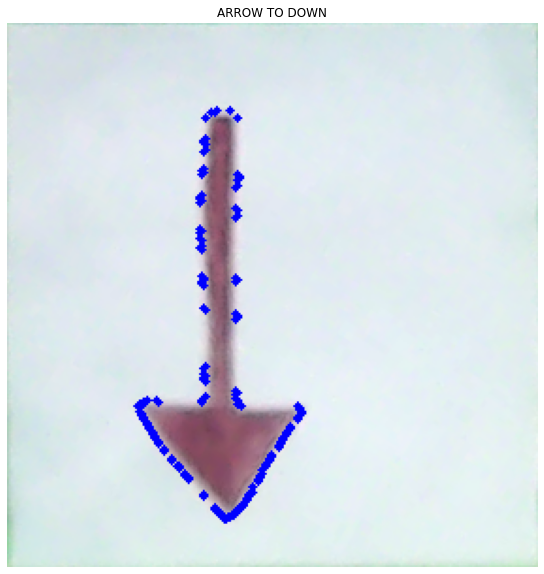

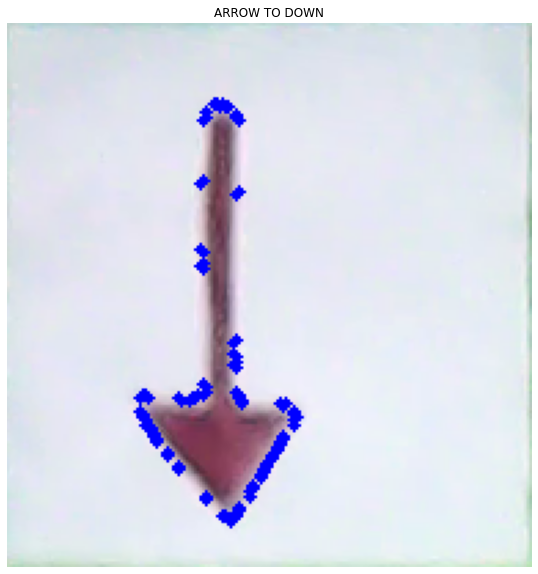

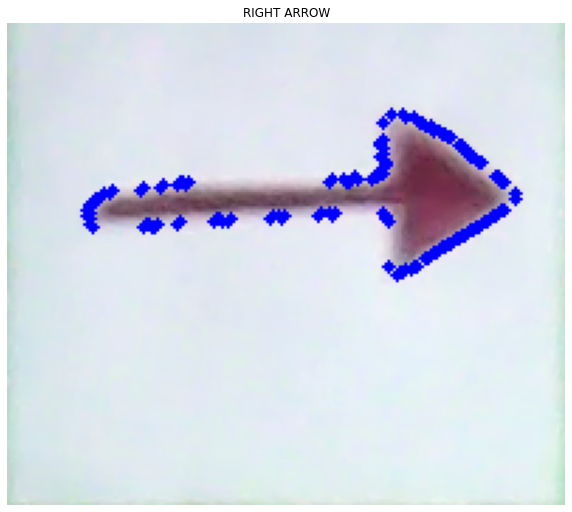

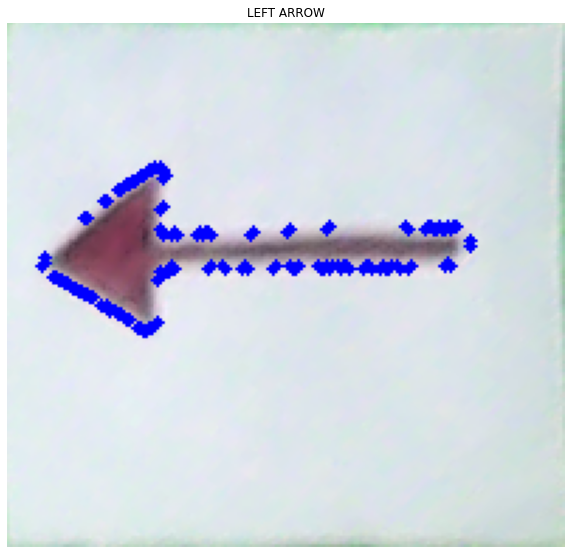

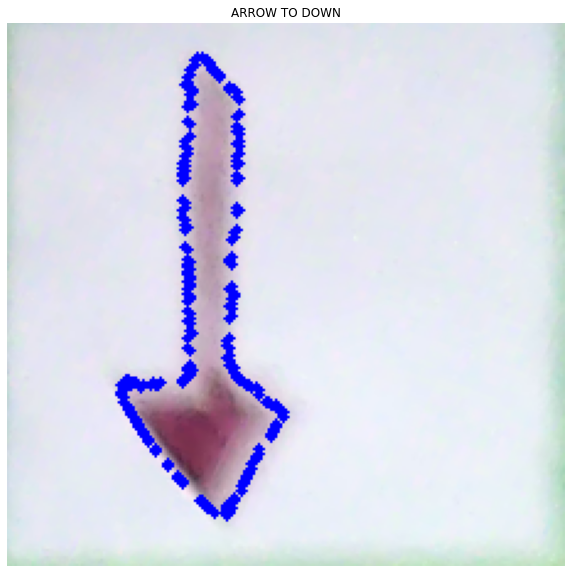

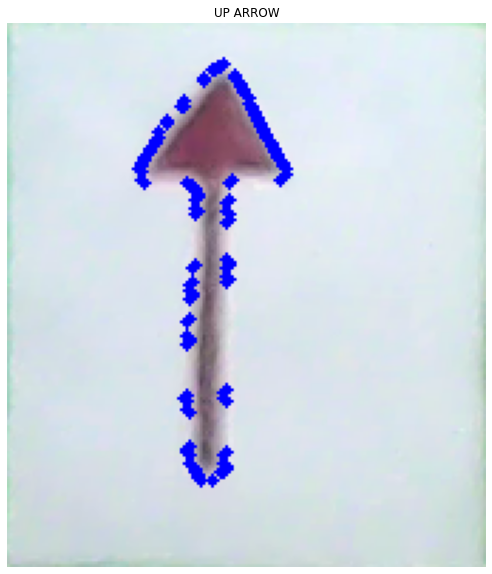

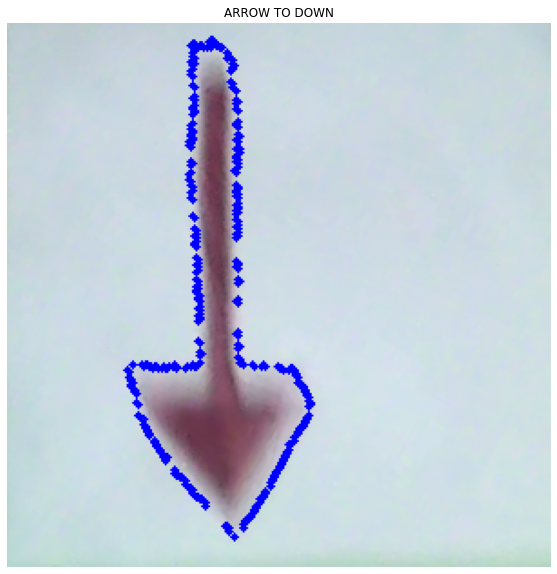

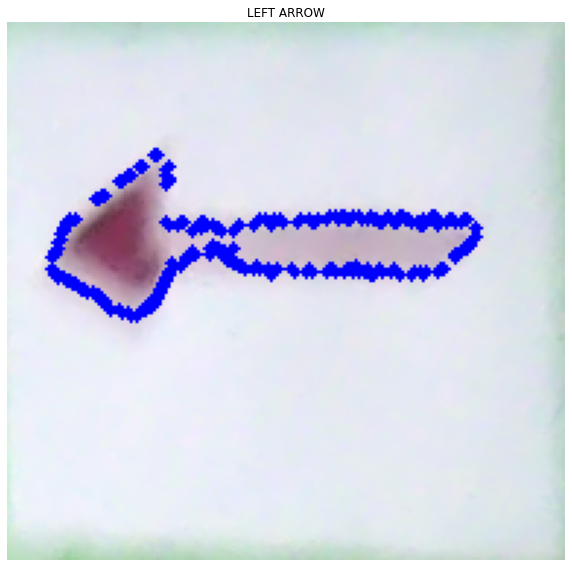

In [ ]:
def cnt_centre(cnt):
    M = cv2.moments(cnt)
    cx = int(M['m10']/M['m00'])
    cy = int(M['m01']/M['m00'])

    return cx, cy

def direction_search(points):
    values_x = []
    values_y = []
    x_max = [] 
    x_min = []
    y_max = []
    y_min = []
    Mx, My = cnt_centre(points)

    for i in range(len(points)):
        values_x.append(points[i][0][0])
        values_y.append(points[i][0][1])
    
    x_max = points[np.argmax(values_x)][0]
    x_min = points[np.argmin(values_x)][0]
    y_max = points[np.argmax(values_y)][0]
    y_min = points[np.argmin(values_y)][0]

    if ( x_max[0] - x_min[0] > y_max[1] - y_min[1] ):
        if ( Mx - x_min[0] < x_max[0] - Mx):
            title = "LEFT ARROW"
        else:
            title = "RIGHT ARROW"
    else:
        if ( My - y_min[1] < y_max[1] - My):
            title = "UP ARROW"
        else:
            title = "ARROW TO DOWN"

    return title

def output(img, cnt, title):
    cv2.drawContours(img, cnt, -1, (0, 0, 255), 3)
    plt.title(title)
    plt.imshow (img)
    plt.axis ('off')
    plt.show ()

for i in range(len(warped_imgs)):
    img = warped_imgs[i]
    img_gr = cv2.cvtColor (img, cv2.COLOR_RGB2GRAY)
    img_binary = cv2.threshold(img_gr, 205, 255, cv2.THRESH_BINARY)[1]
    
    contours, hierarchy = cv2.findContours (img_binary, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    arrow = []
    for j in range(len(contours)):
        if ( 10000 > cv2.contourArea(contours[j]) > 2000 ):
            arrow = contours[j]
            break

    title = direction_search(arrow)
    output(img, arrow, title)
    

## №5

In [ ]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)


Mounted at /content/drive/


In [ ]:
%cd /content/drive/MyDrive/c_vision

/content/drive/MyDrive/c_vision


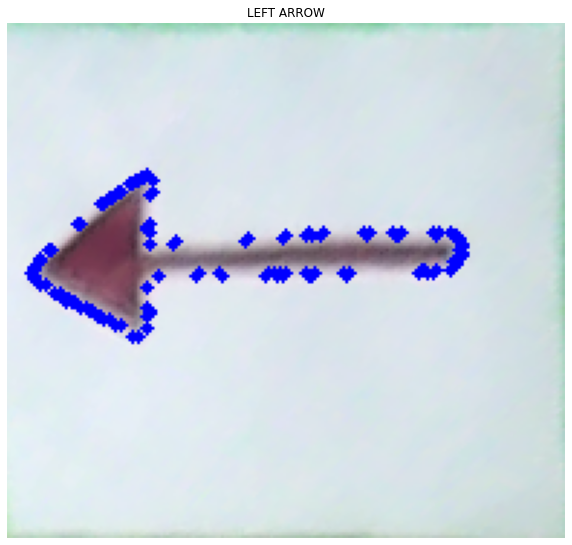

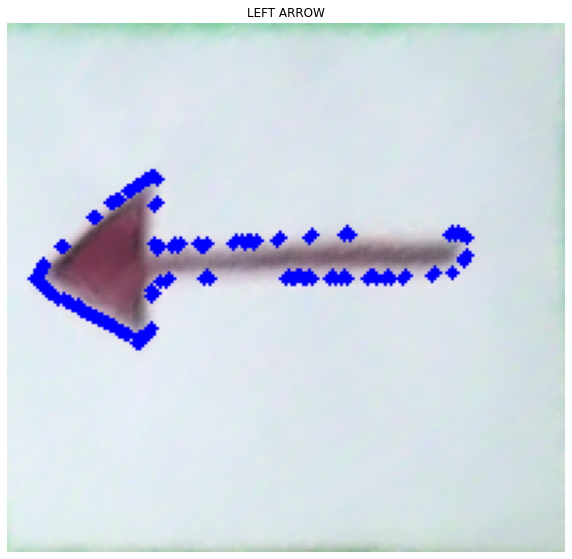

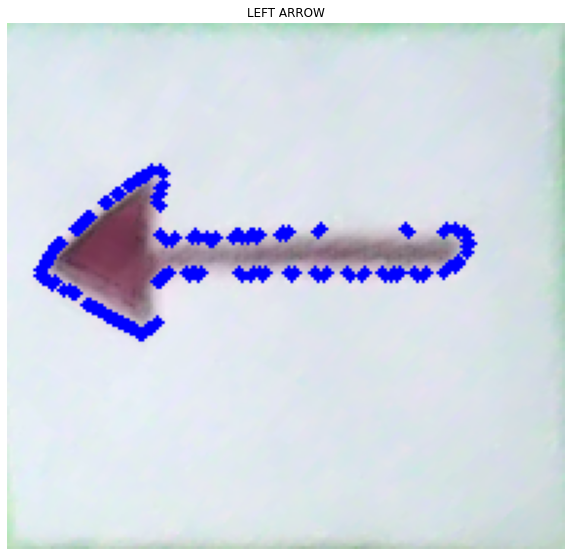

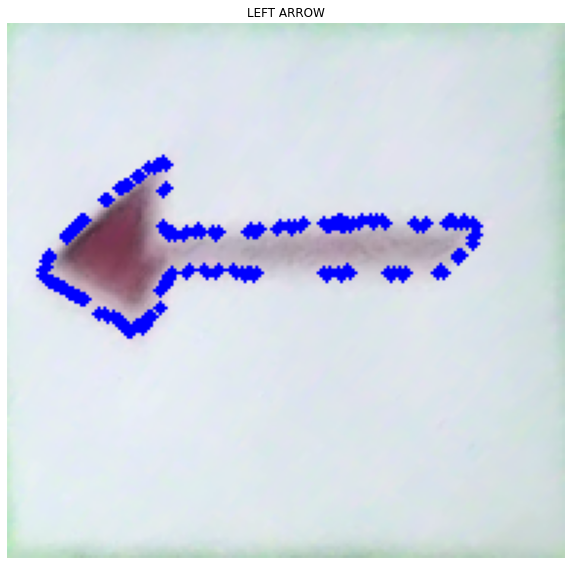

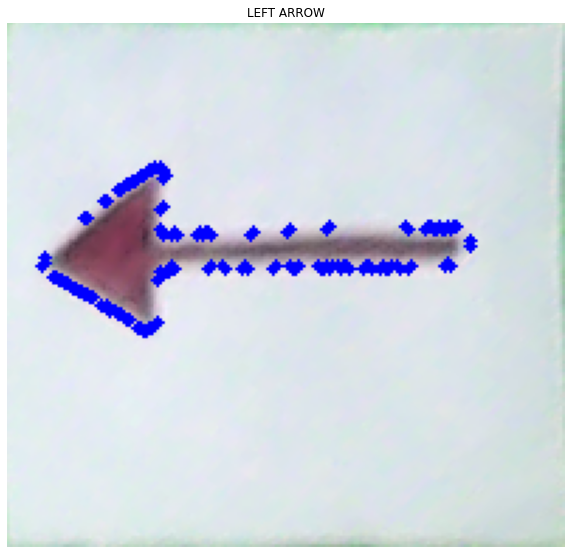

...

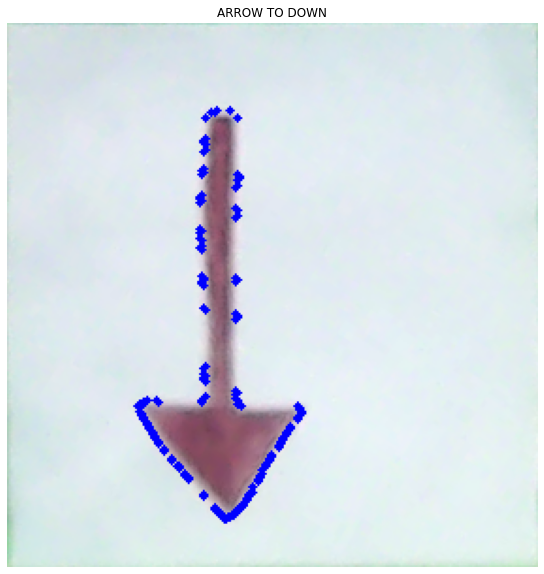

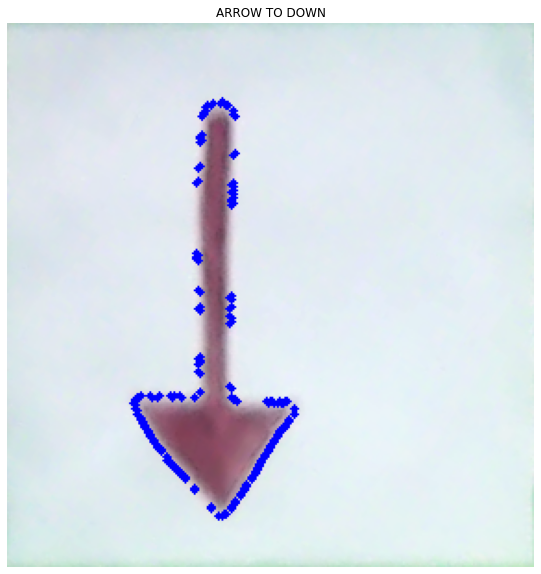

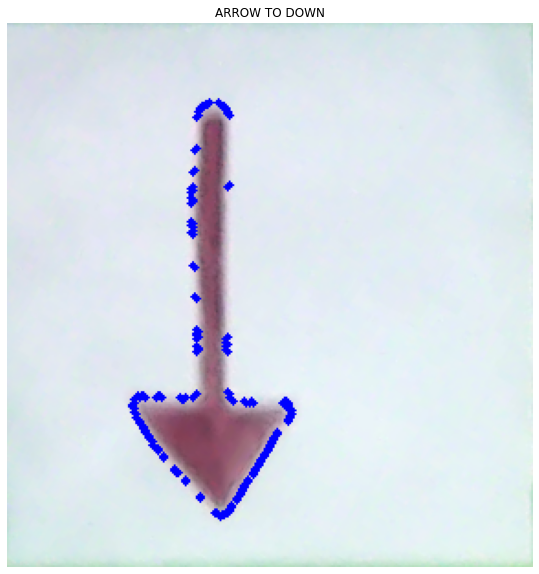

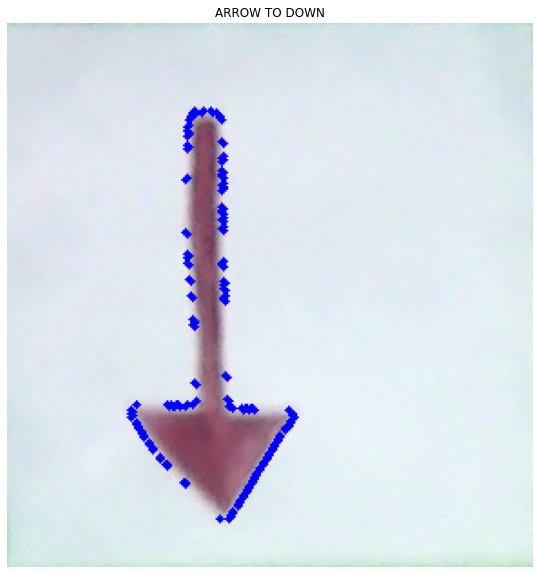

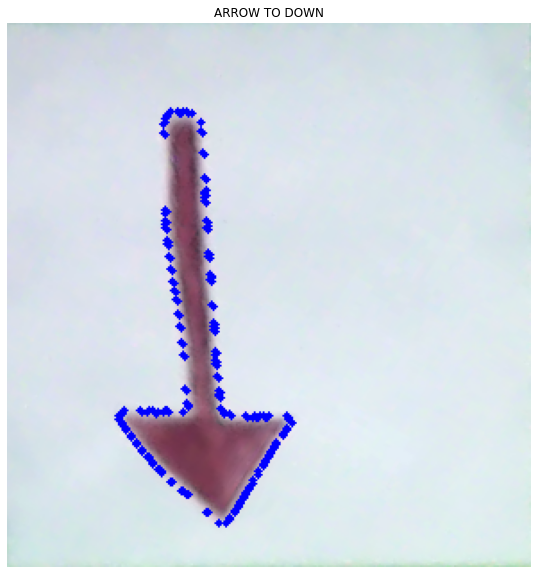

In [22]:
import numpy as np
import cv2
import time
import os
import math
import sys
from matplotlib import pyplot as plt

cap = cv2.VideoCapture('/content/drive/MyDrive/c_vision/3.mov')
low_th  = (180, 180, 180)
high_th = (255, 255, 255)

def find_contour (img, low_th, high_th):
    img_rgb = cv2.cvtColor (img, cv2.COLOR_BGR2RGB)
    
    mask = cv2.inRange (img, low_th, high_th)
    
    contours, hierarchy = cv2.findContours (mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnt = contours [len(contours) - 1]
    #print(contours)
    approx = cv2.convexHull (cnt)

    epsilon = 0.05 * cv2.arcLength (approx, True)
    approx = cv2.approxPolyDP (approx, epsilon, True)

    return approx

def find_distance (img):
    low_th  = (180, 180, 180)
    high_th = (255, 255, 255)

    contour = find_contour (img, low_th, high_th)
    
    length = cv2.arcLength (contour, True)

    if length != 0:
        distance = 180.0 * 364 / length
    else:
        distance = 0
    
    return distance

def order_points(pts):
    rect = np.zeros((4, 2), dtype="float32")
    
    s = pts.sum(axis=1)
    rect[0] = pts[np.argmin(s)]
    rect[2] = pts[np.argmax(s)]
    pts[np.argmax(s)] = [0, 0]
    pts[np.argmin(s)] = [0, 0]    

    s = pts.sum(axis=1)
    rect[3] = pts[np.argmax(s)]
    s[np.argmax(s)] = 0
    for i in range(len(s)):
        if s[i] != 0:
            rect[1] = pts[i]

    return rect

def four_point_transform(image, pts):
    rect = order_points(pts)
    (tl, tr, br, bl) = rect
    
    widthA = np.sqrt(((br[0] - bl[0]) ** 2) + ((br[1] - bl[1]) ** 2))
    widthB = np.sqrt(((tr[0] - tl[0]) ** 2) + ((tr[1] - tl[1]) ** 2))
    maxWidth = max(int(widthA), int(widthB))
    
    heightA = np.sqrt(((tr[0] - br[0]) ** 2) + ((tr[1] - br[1]) ** 2))
    heightB = np.sqrt(((tl[0] - bl[0]) ** 2) + ((tl[1] - bl[1]) ** 2))
    maxHeight = max(int(heightA), int(heightB))
    
    dst = np.array([
        [0, 0],
        [maxWidth - 1, 0],
        [maxWidth - 1, maxHeight - 1],
        [0, maxHeight - 1]], dtype="float32")
    
    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(image, M, (maxWidth, maxHeight))
    
    return warped

def cnt_centre(cnt):
    M = cv2.moments(cnt)
    cx = int(M['m10']/M['m00'])
    cy = int(M['m01']/M['m00'])

    return cx, cy

def direction_search(points):
    values_x = []
    values_y = []
    x_max = [] 
    x_min = []
    y_max = []
    y_min = []
    Mx, My = cnt_centre(points)

    for i in range(len(points)):
        values_x.append(points[i][0][0])
        values_y.append(points[i][0][1])
    
    x_max = points[np.argmax(values_x)][0]
    x_min = points[np.argmin(values_x)][0]
    y_max = points[np.argmax(values_y)][0]
    y_min = points[np.argmin(values_y)][0]

    if ( x_max[0] - x_min[0] > y_max[1] - y_min[1] ):
        if ( Mx - x_min[0] < x_max[0] - Mx):
            title = "LEFT ARROW"
        else:
            title = "RIGHT ARROW"
    else:
        if ( My - y_min[1] < y_max[1] - My):
            title = "UP ARROW"
        else:
            title = "ARROW TO DOWN"

    return title

def output(img, cnt, title):
    cv2.drawContours(img, cnt, -1, (0, 0, 255), 3)
    plt.title(title)
    plt.imshow (img)
    plt.axis ('off')
    plt.show ()

lost_frames = 0
while(cap.isOpened()):
    ret, frame = cap.read()
    
    if frame is not None:
        if len(frame) != 0:
            img = frame
            approx_cnt = find_contour(img, low_th, high_th)
            warped = four_point_transform (img, np.asarray (approx_cnt) [:, 0, :])

            img_gr = cv2.cvtColor (warped, cv2.COLOR_RGB2GRAY)
            img_binary = cv2.threshold(img_gr, 205, 255, cv2.THRESH_BINARY)[1]
    
            contours, hierarchy = cv2.findContours (img_binary, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
            arrow = []
            for j in range(len(contours)):
                 if ( 10000 > cv2.contourArea(contours[j]) > 2000 ):
                     arrow = contours[j]
                 break
        if len(arrow) != 0:
            title = direction_search(arrow)
            output(warped, arrow, title)
    else:
        lost_frames += 1
    
    if lost_frames > 10:
        break
    

cap.release()